# Team Lior Notebook
> World Data League 2021

Team members:
*   Steven Vuong (Team Leader)
*   Vinay Varsani
*   Hardique Manilal
*   Sachiyo Daley 


## Introduction
We aim to describe the characteristics of former regular users of public transport. Examine why these people stopped using public transport and explore what would turn a person to become regular users again. The data provided can reveal through empirical results differences between current and ex-regular users, namely in relation to gender and age. Based on the data exploration and empirical results for the public transport service are addressed in the conclusion. 








## Development
- Goal: Explore Data Provided by WDL on Urban Mobility



### 0: Prep our notebook

In [ ]:
# install holoviews and hvplot
!pip install holoviews==1.4.2
!pip install hvplot

# import + settings
import holoviews as hv
hv.extension('bokeh')

In [ ]:
!python3 -m pip install -r https://raw.githubusercontent.com/StevenVuong/WDL_2020/master/requirements.txt

In [3]:
# import necessary packages
import os
import pandas as pd
import numpy as np
from scipy.special import boxcox1p
import seaborn as sns
import matplotlib.pyplot as plt
import requests

%matplotlib inline
plt.rcParams['figure.figsize'] = (20, 10) # set default sizing

In [4]:
import warnings
warnings.filterwarnings('ignore')

In [5]:
# download data
def download_url(url, save_path, chunk_size=128):
    r = requests.get(url, stream=True)
    with open(save_path, 'wb') as fd:
        for chunk in r.iter_content(chunk_size=chunk_size):
            fd.write(chunk)

In [6]:
download_url('http://mapas.dgterritorio.pt/ATOM-download/CAOP-Cont/Cont_AAD_CAOP2020.zip', '/content/Cont_AAD_CAOP2020.zip')
!unzip /content/Cont_AAD_CAOP2020.zip
download_url('https://raw.githubusercontent.com/StevenVuong/WDL_2020/master/data/stage1/Churn_OD.txt','/content/Churn_OD.txt')
download_url('https://raw.githubusercontent.com/StevenVuong/WDL_2020/master/data/stage1/Churn_UsersProfile.txt','/content/Churn_UsersProfile.txt')


Archive:  /content/Cont_AAD_CAOP2020.zip
  inflating: Cont_AAD_CAOP2020.CPG   
  inflating: Cont_AAD_CAOP2020.shx   
  inflating: Cont_AAD_CAOP2020.shp   
  inflating: Cont_AAD_CAOP2020.prj   
  inflating: Cont_AAD_CAOP2020.dbf   


In [7]:
# build data directory
data_dir = '/content'
os.listdir(data_dir)

['.config',
 'Cont_AAD_CAOP2020.prj',
 'Cont_AAD_CAOP2020.dbf',
 'Churn_OD.txt',
 'Churn_UsersProfile.txt',
 'Cont_AAD_CAOP2020.shx',
 'Cont_AAD_CAOP2020.zip',
 'Cont_AAD_CAOP2020.CPG',
 'Cont_AAD_CAOP2020.shp',
 'sample_data']

### 1: Churn User Profile Data
We will be examining this first

In [8]:
# Load user profiles
user_profiles_df = pd.read_csv(
    os.path.join(data_dir, 'Churn_UsersProfile.txt'), 
    delimiter = "|",
    encoding = "ISO-8859-1"
)
user_profiles_df.head()

,Region_of_Origin,District_of_Origin,County_of_Origin,Period,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day
0,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,15-24,294.194206
1,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,25-34,1081.652817
2,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,35-44,235.836653
3,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,45-54,840.951323
4,R1 - AM Lisboa,Lisboa,Amadora,Sep-19 to Feb-20,Female,55-64,1216.148092


#### 1.1: Inspect Data

In [9]:
# sample some user profiles
user_profiles_df.sample(5)

,Region_of_Origin,District_of_Origin,County_of_Origin,Period,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day
348,R1 - AM Lisboa,Lisboa,Vila Franca de Xira,Sep-20 to Jan-21,Female,55-64,877.417957
233,R2 - AM Porto,Porto,Trofa,Sep-19 to Feb-20,Female,35-44,33.109745
308,R1 - AM Lisboa,Lisboa,Mafra,Sep-20 to Jan-21,Male,55-64,231.502177
342,R1 - AM Lisboa,Lisboa,Sintra,Sep-20 to Jan-21,Male,55-64,608.485062
178,R2 - AM Porto,Aveiro,Santa Maria da Feira,Sep-19 to Feb-20,Male,35-44,130.878587


In [10]:
# checking for missing data 
user_profiles_df.isna().sum()

Region_of_Origin            0
District_of_Origin          0
County_of_Origin            0
Period                      0
GenderDescription           0
AgeClassDescription         0
Average_BusUsers_per_Day    0
dtype: int64

In [11]:
# checking for duplicate rows
user_profiles_df.duplicated().sum()

0

We can see that there is:
- no missing data 
- there are no duplicated rows 



#### 1.2: Basic Data Wrangling
-  Calculation and exploring churn rate
-  Separate period to `period_start`, `period_end` and `period_length`


In [12]:
user_profiles_df['Period'].unique()

array(['Sep-19 to Feb-20', 'Sep-20 to Jan-21'], dtype=object)

##### 1.2.1Filter for the two periods 
- do we need to normalise for the extra month on p1? - how?
P2 during pandemic?

In [13]:
period1 = (user_profiles_df.loc[user_profiles_df['Period'] == 'Sep-19 to Feb-20']
             .rename(columns={'Average_BusUsers_per_Day': 'Average_BusUsers_per_Day_p1'})
             .drop(columns = ['Period']))
period2 = (user_profiles_df.loc[user_profiles_df['Period'] == 'Sep-20 to Jan-21']
             .rename(columns={'Average_BusUsers_per_Day': 'Average_BusUsers_per_Day_p2'})
             .drop(columns = ['Period']))
period2.head(1)

,Region_of_Origin,District_of_Origin,County_of_Origin,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day_p2
255,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,536.005174


In [14]:
# Join the two period tables to get a side by side view of Average Bus users per
# day per user profile
df_merged = pd.merge(period1, period2, on=['District_of_Origin',
                                           'County_of_Origin',
                                           'GenderDescription', 
                                           'AgeClassDescription'
                                           ])

In [15]:
df_merged['Churn'] = df_merged['Average_BusUsers_per_Day_p2'] - df_merged['Average_BusUsers_per_Day_p1']
df_merged['Churn_percent'] = ((df_merged['Average_BusUsers_per_Day_p2'] - df_merged['Average_BusUsers_per_Day_p1'])/ df_merged['Average_BusUsers_per_Day_p1'])*100

In [16]:
df_merged.sort_values(by=['Churn_percent'], ascending = False).head(10)

,Region_of_Origin_x,District_of_Origin,County_of_Origin,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day_p1,Region_of_Origin_y,Average_BusUsers_per_Day_p2,Churn,Churn_percent
139,R1 - AM Lisboa,Setúbal,Seixal,Male,15-24,37.697725,R1 - AM Lisboa,1631.340763,1593.643038,4227.424965
103,R1 - AM Lisboa,Setúbal,Almada,Male,25-34,17.528597,R1 - AM Lisboa,497.588139,480.059542,2738.721998
63,R1 - AM Lisboa,Lisboa,Oeiras,Female,25-34,21.863276,R1 - AM Lisboa,447.437221,425.573945,1946.524139
238,R2 - AM Porto,Porto,Vila Nova de Gaia,Male,55-64,21.943108,R2 - AM Porto,374.627538,352.684430,1607.267439
223,R2 - AM Porto,Porto,Valongo,Male,25-34,27.625672,R2 - AM Porto,366.664832,339.039160,1227.261223
184,R2 - AM Porto,Porto,Maia,Female,55-64,49.697015,R2 - AM Porto,414.680964,364.983949,734.418252
7,R1 - AM Lisboa,Lisboa,Amadora,Male,35-44,137.697607,R1 - AM Lisboa,723.561851,585.864244,425.471623
94,R1 - AM Lisboa,Lisboa,Vila Franca de Xira,Male,55-64,141.556626,R1 - AM Lisboa,693.873061,552.316435,390.173495
121,R1 - AM Lisboa,Setúbal,Montijo,Female,35-44,65.504612,R1 - AM Lisboa,317.566534,252.061922,384.800267
39,R1 - AM Lisboa,Lisboa,Loures,Female,65+,147.474840,R1 - AM Lisboa,702.814481,555.339641,376.565685


In [17]:
#Analyse transport use changes for each age group
df_age_comp = (df_merged.groupby(['AgeClassDescription'])
                        .agg({'Average_BusUsers_per_Day_p1': 'sum',
                              'Average_BusUsers_per_Day_p2': 'sum'}))

df_age_comp['Churn'] = df_age_comp['Average_BusUsers_per_Day_p2'] - df_age_comp['Average_BusUsers_per_Day_p1']
df_age_comp['Churn_percent'] = ((df_age_comp['Average_BusUsers_per_Day_p2'] - df_age_comp['Average_BusUsers_per_Day_p1'])/ df_age_comp['Average_BusUsers_per_Day_p1'])*100
df_age_comp.head(10)

,Average_BusUsers_per_Day_p1,Average_BusUsers_per_Day_p2,Churn,Churn_percent
AgeClassDescription,,,,
15-24,38287.457553,21844.347320,-16443.110233,-42.946467
25-34,32792.788327,15571.847812,-17220.940515,-52.514414
35-44,29652.700723,20061.064491,-9591.636232,-32.346586
45-54,45707.615627,27429.148887,-18278.466740,-39.989981
55-64,51675.402952,32439.272948,-19236.130004,-37.224925
65+,191713.975969,107189.407724,-84524.568245,-44.088892


In [18]:
# Analyse transport use changes per Region
df_loc_comp = (df_merged.groupby([ 'District_of_Origin','County_of_Origin'])
                        .agg({'Average_BusUsers_per_Day_p1': 'sum',
                              'Average_BusUsers_per_Day_p2': 'sum'}))

df_loc_comp['Churn'] = df_loc_comp['Average_BusUsers_per_Day_p2'] - df_loc_comp['Average_BusUsers_per_Day_p1']
df_loc_comp['Churn_percent'] = ((df_loc_comp['Average_BusUsers_per_Day_p2'] - df_loc_comp['Average_BusUsers_per_Day_p1'])/ df_loc_comp['Average_BusUsers_per_Day_p1'])*100
# df_loc_comp.head(100)

In [19]:
df_loc_comp_churn = (df_merged.groupby(['District_of_Origin','County_of_Origin'])
                        .agg({'Churn_percent': 'mean'}))

In [20]:
df_merged.head()

,Region_of_Origin_x,District_of_Origin,County_of_Origin,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day_p1,Region_of_Origin_y,Average_BusUsers_per_Day_p2,Churn,Churn_percent
0,R1 - AM Lisboa,Lisboa,Amadora,Female,15-24,294.194206,R1 - AM Lisboa,536.005174,241.810968,82.194334
1,R1 - AM Lisboa,Lisboa,Amadora,Female,25-34,1081.652817,R1 - AM Lisboa,408.068335,-673.584482,-62.273631
2,R1 - AM Lisboa,Lisboa,Amadora,Female,35-44,235.836653,R1 - AM Lisboa,478.337192,242.500539,102.825636
3,R1 - AM Lisboa,Lisboa,Amadora,Female,45-54,840.951323,R1 - AM Lisboa,571.192813,-269.758510,-32.077779
4,R1 - AM Lisboa,Lisboa,Amadora,Female,55-64,1216.148092,R1 - AM Lisboa,741.072367,-475.075725,-39.063970


##### 1.2.2 Plots 

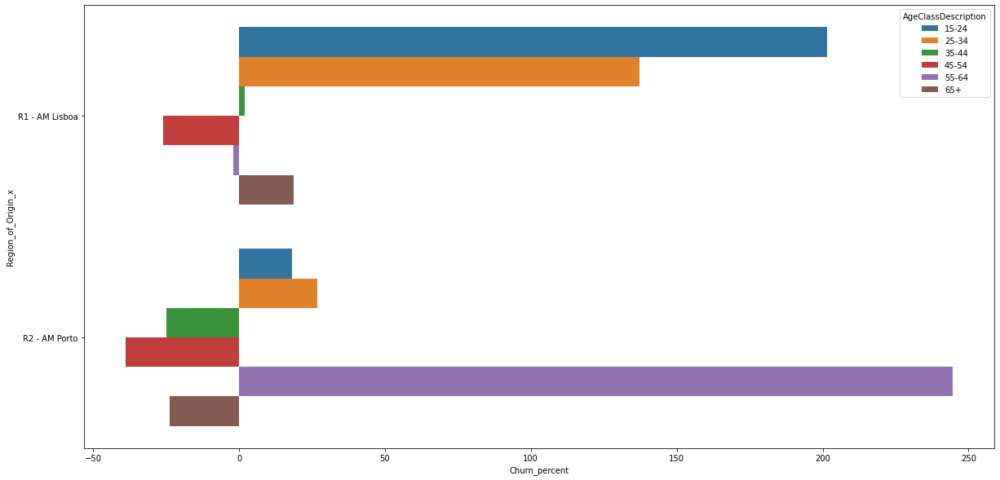

In [21]:
col = 'Region_of_Origin_x'
graph1 = sns.barplot(data = df_merged
                    , x = 'Churn_percent'
                    , y = col
                    , hue = 'AgeClassDescription'
                    # , col = 'GenderDescription'
                    , palette=None
                    , ci = None)

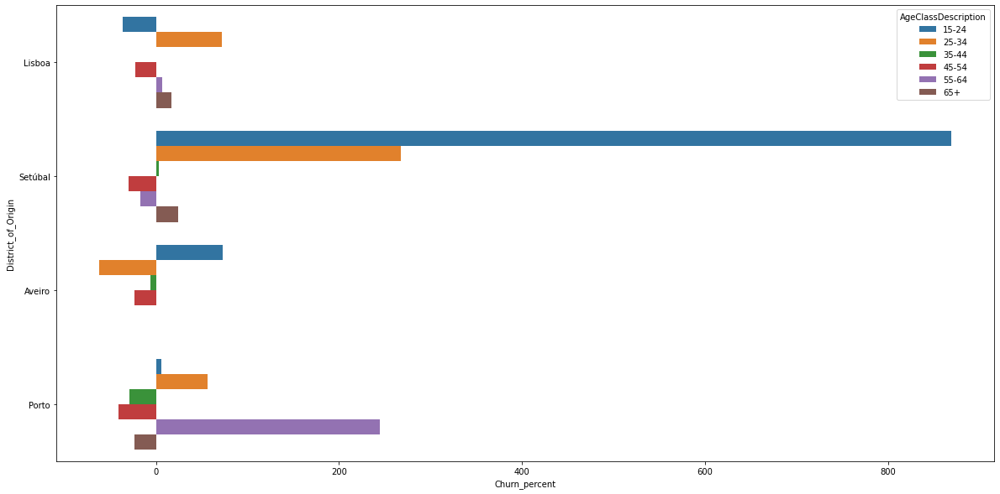

In [22]:
col = 'District_of_Origin'
graph2 = sns.barplot(data = df_merged
                    , x = 'Churn_percent'
                    , y = col
                    , hue = 'AgeClassDescription'
                    # , col = 'GenderDescription'
                    , palette=None
                    , ci = None)

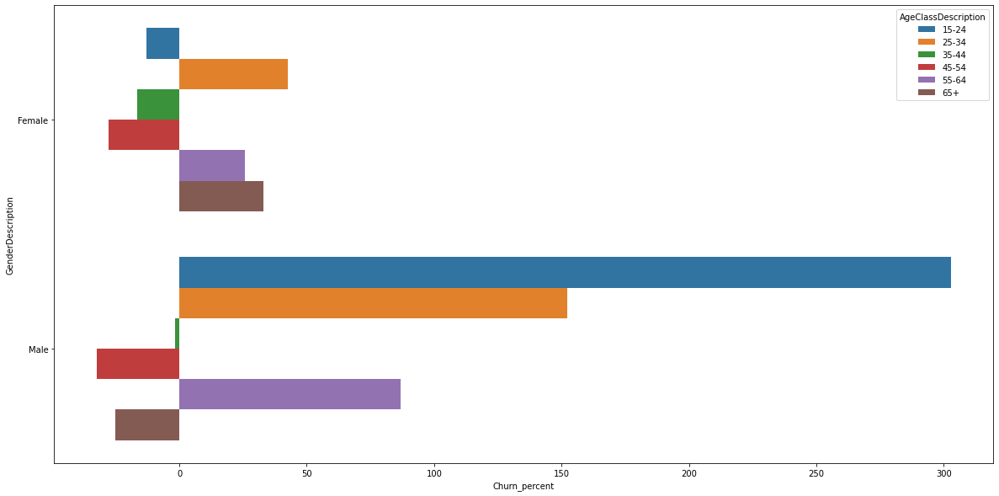

In [23]:
col = 'GenderDescription'
graph3 = sns.barplot(data = df_merged
                    , x = 'Churn_percent'
                    , y = col
                    , hue = 'AgeClassDescription'
                    # , col = 'GenderDescription'
                    , palette=None
                    , ci = None)

Findings:
- we can see that the two youngest age group are the only one the have a significant positive increase the churn as they join 


#### 1.3: More in depth Data Wrangling
-  Make a new column for R1/R2 from Region_of_Origin
-  Make a new column for Region of origin anything after `- AM`
-  Convert columns to categorical
-  Separate period to `period_start`, `period_end` and `period_length`

Assumptions:
-  Period start is on the first day of the month and up to the final day in the last month

In [24]:
# make new columns from Region_of_Origin
user_profiles_df['origin_region_number'] = user_profiles_df['Region_of_Origin'].str.split(' ').str[0]
user_profiles_df['origin_region'] = user_profiles_df['Region_of_Origin'].str.split('- AM',1).str[1]
user_profiles_df.drop('Region_of_Origin', axis=1, inplace=True)

In [25]:
# There are only two periods that we have; seems like wrangling dates wasn't necessary
user_profiles_df['Period'].value_counts()

Sep-20 to Jan-21    289
Sep-19 to Feb-20    255
Name: Period, dtype: int64

In [26]:
# convert types to categorical
to_cat_cols = ['District_of_Origin','County_of_Origin','Period','GenderDescription','AgeClassDescription','origin_region_number','origin_region']
for col in to_cat_cols:
    user_profiles_df[col] = user_profiles_df[col].astype('category')

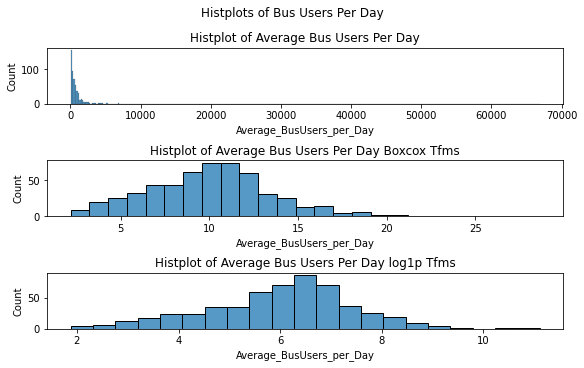

In [27]:
fig, axs = plt.subplots(3, 1, figsize=(8, 5), constrained_layout=True)
fig.suptitle('Histplots of Bus Users Per Day')

sns.histplot(user_profiles_df['Average_BusUsers_per_Day'], ax=axs[0]);
axs[0].set(title='Histplot of Average Bus Users Per Day');

sns.histplot(boxcox1p(user_profiles_df['Average_BusUsers_per_Day'], 0.15), ax=axs[1]);
axs[1].set(title='Histplot of Average Bus Users Per Day Boxcox Tfms');

sns.histplot(np.log1p(user_profiles_df['Average_BusUsers_per_Day']), ax=axs[2]);
axs[2].set(title='Histplot of Average Bus Users Per Day log1p Tfms');
plt.show()

The data is heavily skewed to the right, this due to the fact this data set doesn’t include data from all type of transport available to the users. Applying a transform will five back a normal distribution, that we would get if we had the complete that data of the public transport environment.
Looks like applying a log1p transformation transforms the data gave us a  normal distribution; we'll do that and plot with it. 

In [28]:
# Applying a log1p transformation transforms
user_profiles_df['log1p_avg_daily_bus_users'] = np.log1p(user_profiles_df['Average_BusUsers_per_Day'])

##### 1.3.1: Plots

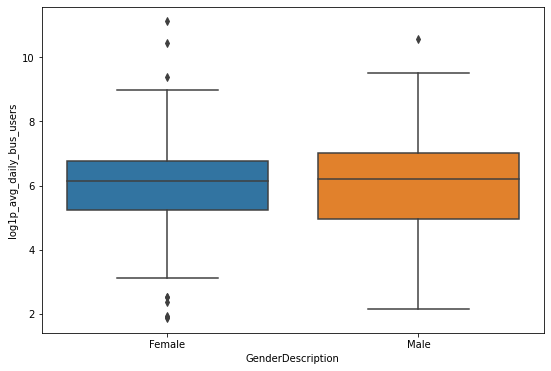

In [29]:
plt.figure(figsize=(9,6))
sns.boxplot(x='GenderDescription', y='log1p_avg_daily_bus_users',data=user_profiles_df);

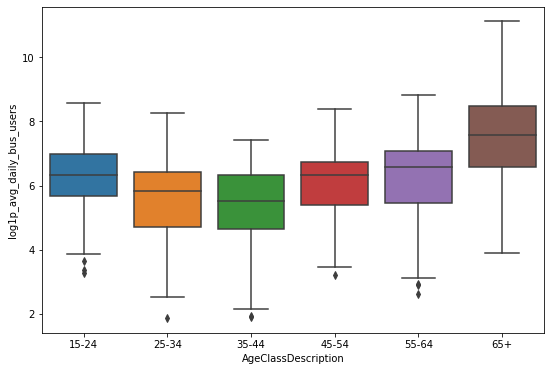

In [30]:
plt.figure(figsize=(9,6))
sns.boxplot(x='AgeClassDescription', y='log1p_avg_daily_bus_users',data=user_profiles_df);

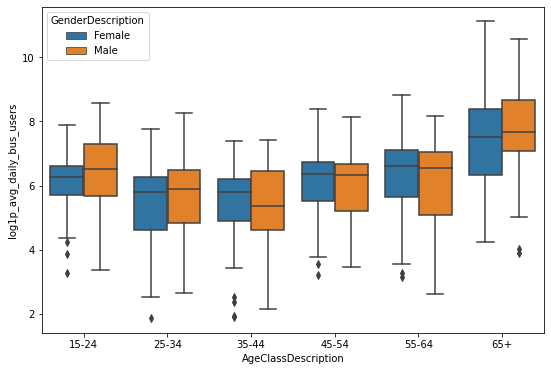

In [31]:
# look at average bus users per day by gender
plt.figure(figsize=(9,6))
sns.boxplot(x='AgeClassDescription', y='log1p_avg_daily_bus_users', hue='GenderDescription',data=user_profiles_df);

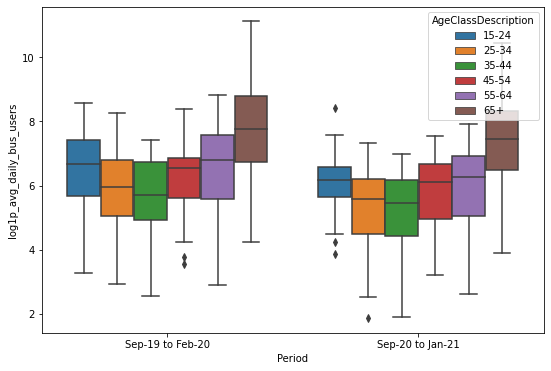

In [32]:
plt.figure(figsize=(9,6))
sns.boxplot(x='Period', y='log1p_avg_daily_bus_users', hue='AgeClassDescription',data=user_profiles_df);

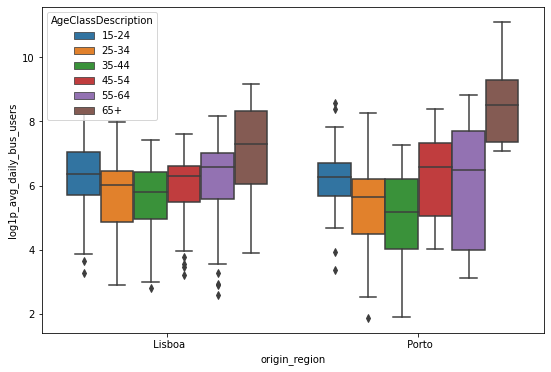

In [33]:
# are we looking over the both periods???
plt.figure(figsize=(9,6))
sns.boxplot(x='origin_region', y='log1p_avg_daily_bus_users', hue='AgeClassDescription',data=user_profiles_df);

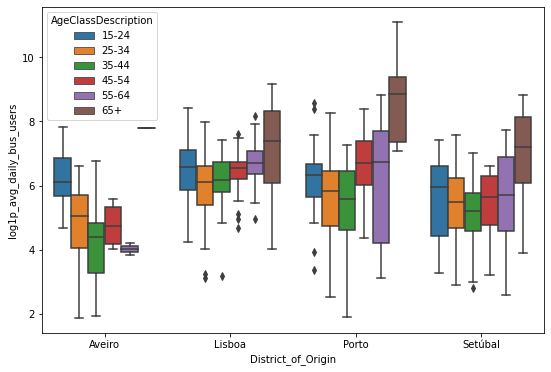

In [34]:
plt.figure(figsize=(9,6))
sns.boxplot(x='District_of_Origin', y='log1p_avg_daily_bus_users', hue='AgeClassDescription',data=user_profiles_df);

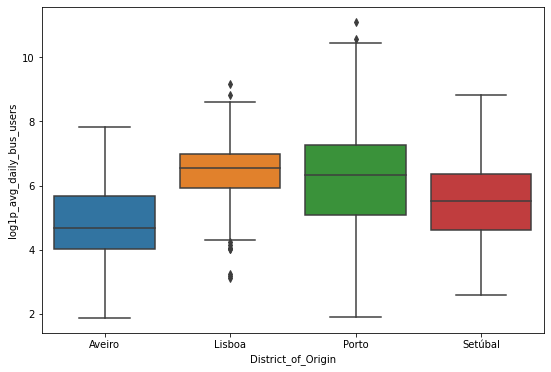

In [35]:
plt.figure(figsize=(9,6))
sns.boxplot(x='District_of_Origin', y='log1p_avg_daily_bus_users',data=user_profiles_df);

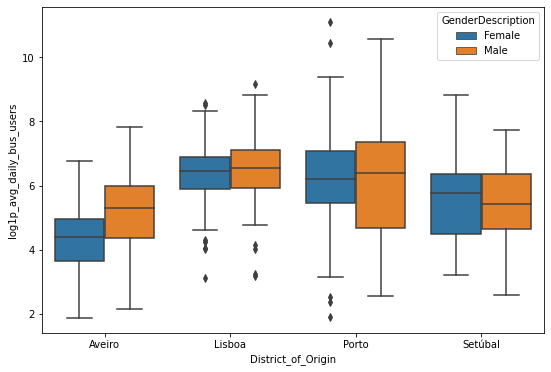

In [36]:
plt.figure(figsize=(9,6))
sns.boxplot(x='District_of_Origin', y='log1p_avg_daily_bus_users', hue='GenderDescription',data=user_profiles_df);

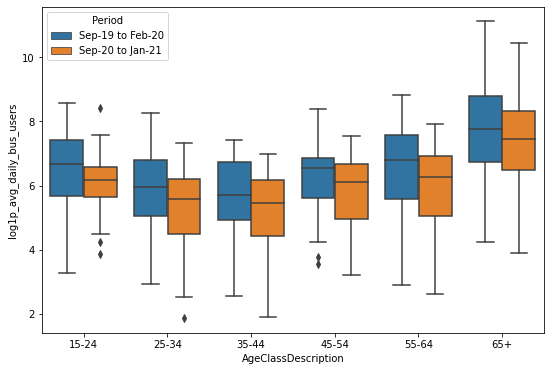

In [37]:
plt.figure(figsize=(9,6))
sns.boxplot(x='AgeClassDescription', y='log1p_avg_daily_bus_users', hue='Period',data=user_profiles_df);

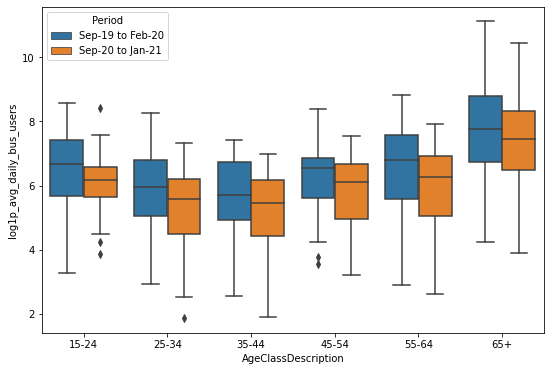

In [38]:
plt.figure(figsize=(9,6))
sns.boxplot(x='AgeClassDescription', y='log1p_avg_daily_bus_users', hue='Period',data=user_profiles_df);

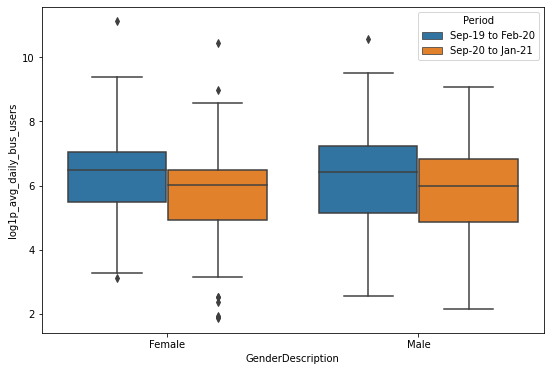

In [39]:
plt.figure(figsize=(9,6))
sns.boxplot(x='GenderDescription', y='log1p_avg_daily_bus_users', hue='Period',data=user_profiles_df);

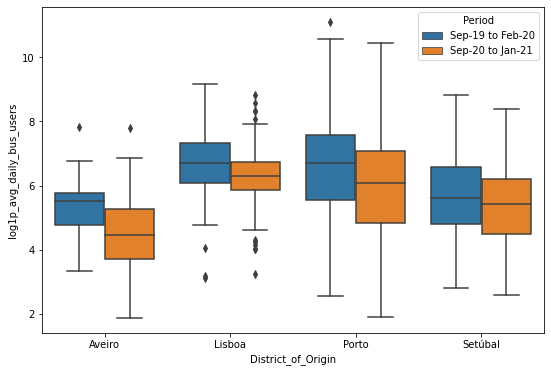

In [40]:
plt.figure(figsize=(9,6))
sns.boxplot(x='District_of_Origin', y='log1p_avg_daily_bus_users', hue='Period',data=user_profiles_df);

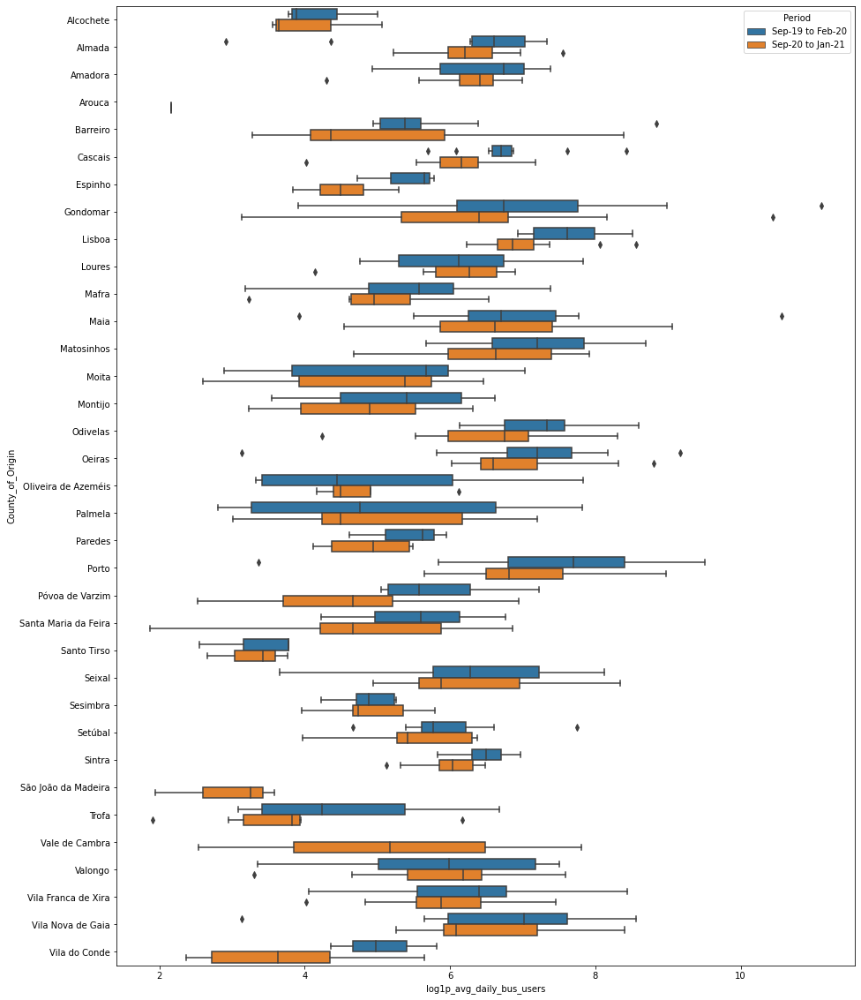

In [41]:
plt.figure(figsize=(15,20))
sns.boxplot(y='County_of_Origin', x='log1p_avg_daily_bus_users', hue='Period',data=user_profiles_df, orient='h');

Findings:
-  Males and females have similar median, upper and lower ranges however there are more extreme cases for female bus users
-  Elderly (65+) have the highest median for usage of busses; middle age (35-44) have the lowest median
-  Female middle age have the lowest bus usage in age range (35-44) and slightly higher than males in age range (15-24)
-  There were slightly more users from Sep-2020 to Jan 2021 than Sep-19 to Feb-20
    -  Slight confusion as Pandemic hit Europe around March 2020? So Sep-20 to Jan-2021 is during the pandemic. Do we discount this information? <br>
    Response: Recover some "normality"; Sep-19 to Feb-20 is pre-pandemic and after is post pandemic however no longer under national lockdown so there is still some transportation
    -  Age demographics remain consistent for both of the time periods; elderly rely heavily on public transport
-  Gondomar and Maia have the highest avg_daily_bus_users
-  District of Origin makes a big difference; ages within that vary widely too; Aveiro have the lowest number of daily bus users and Famels from Aveiro even lower
-  Average daily bus users is down from first period to second period. Perhaps this is due to COVID-19, which is the main suspicion at the moment. Though in theory it should be much lower if it were actually COVID? Issue with the data?
-  More people from R2
-  Both male and females used less public transport after each period
-  Usage of public transportation decreased across districts and county of origins; perhaps we can look at these subsets to investigate what has happened

##### 1.3.2: More Investigating subgroups within each Period (before and After)

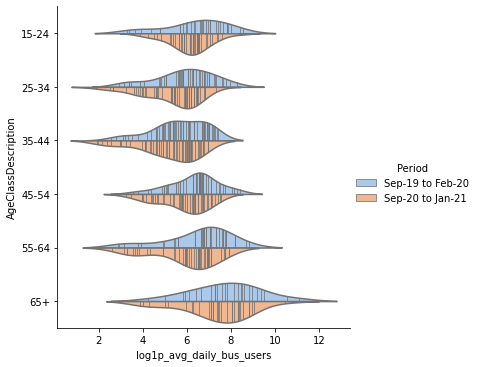

In [42]:
sns.catplot(
    y='AgeClassDescription', 
    x='log1p_avg_daily_bus_users', 
    hue='Period',
    kind='violin',
    inner='stick',
    split=True,
    palette='pastel',
    data=user_profiles_df
);

In [43]:
def show_values_on_bars(axs, h_v="v", space=0.4, decimals=2):
    '''
    Seaborn Barplot - Displaying Values. (2021, april 15). Retrieved 
    from https://stackoverflow.com/questions/43214978/seaborn-barplot-displaying-values
    '''
    def _modify_nan(value, replacement=0.1):
        if np.isnan(value):
            return replacement
        return value
    
    def _show_on_single_plot(ax, decimals=decimals):
        if h_v == "v":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() / 2
                _y = p.get_y() + p.get_height()
                value = round((p.get_height()), decimals)
                value = _modify_nan(value)
                ax.text(_x, _y, value, ha="center") 
        elif h_v == "h":
            for p in ax.patches:
                _x = p.get_x() + p.get_width() + float(space)
                _y = p.get_y() + p.get_height()
                value = round((p.get_width()),decimals)
                value = _modify_nan(value)
                ax.text(_x, _y, value, ha="left")

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

def facegrid_show_value_bars(g, h_v='v'):
    '''
    Seaborn Barplot - Displaying Values. (2021, april 15). Retrieved from 
    https://stackoverflow.com/questions/41127841/how-to-annotate-bars-in-a-seaborn-facetgrid-works-in-factorplot
    '''
    for ax in g.axes.ravel():
        show_values_on_bars(ax, h_v)
    plt.show()

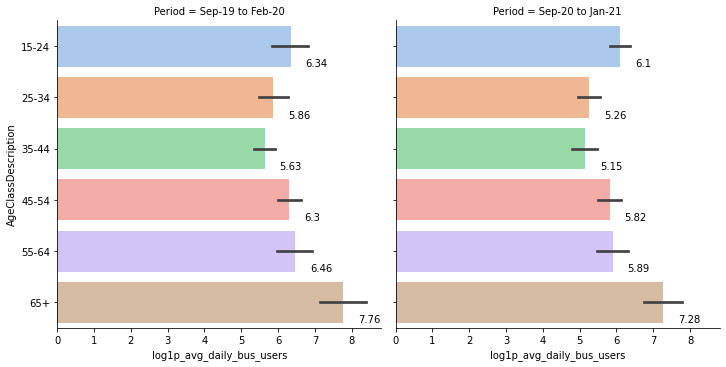

In [44]:
graph = sns.catplot(
    y='AgeClassDescription', 
    x='log1p_avg_daily_bus_users', 
    col='Period',
    kind='bar',
    palette='pastel',
    data=user_profiles_df
);
facegrid_show_value_bars(graph, h_v='h')

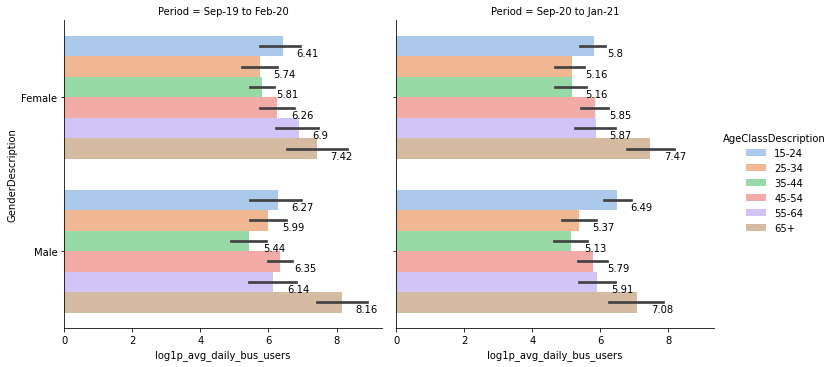

In [45]:
graph = sns.catplot(
    y='GenderDescription', 
    x='log1p_avg_daily_bus_users', 
    col='Period',
    hue='AgeClassDescription',
    kind='bar',
    palette='pastel',
    data=user_profiles_df
);
facegrid_show_value_bars(graph, h_v='h')

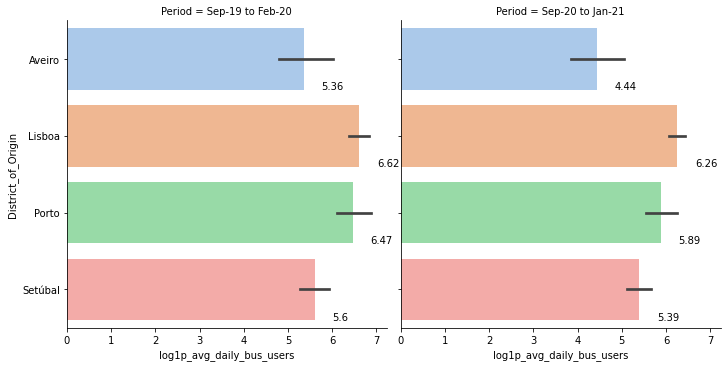

In [46]:
graph = sns.catplot(
    y='District_of_Origin', 
    x='log1p_avg_daily_bus_users', 
    col='Period',
    kind='bar',
    palette='pastel',
    data=user_profiles_df
);
facegrid_show_value_bars(graph, h_v='h')

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


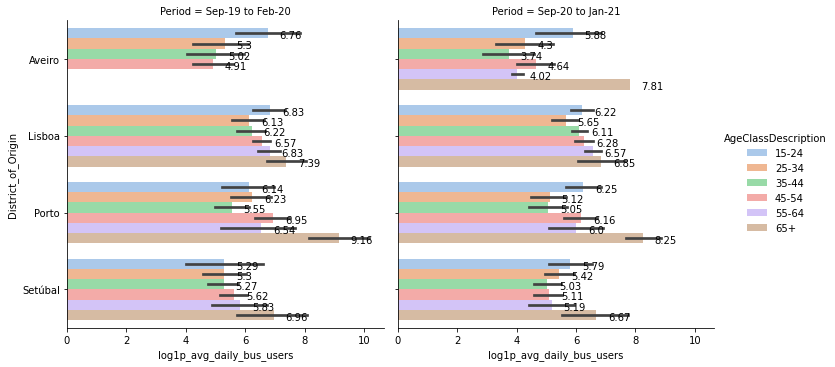

In [47]:
graph = sns.catplot(
    y='District_of_Origin', 
    x='log1p_avg_daily_bus_users', 
    col='Period',
    hue='AgeClassDescription',
    kind='bar',
    palette='pastel',
    data=user_profiles_df
);
facegrid_show_value_bars(graph, h_v='h')

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values


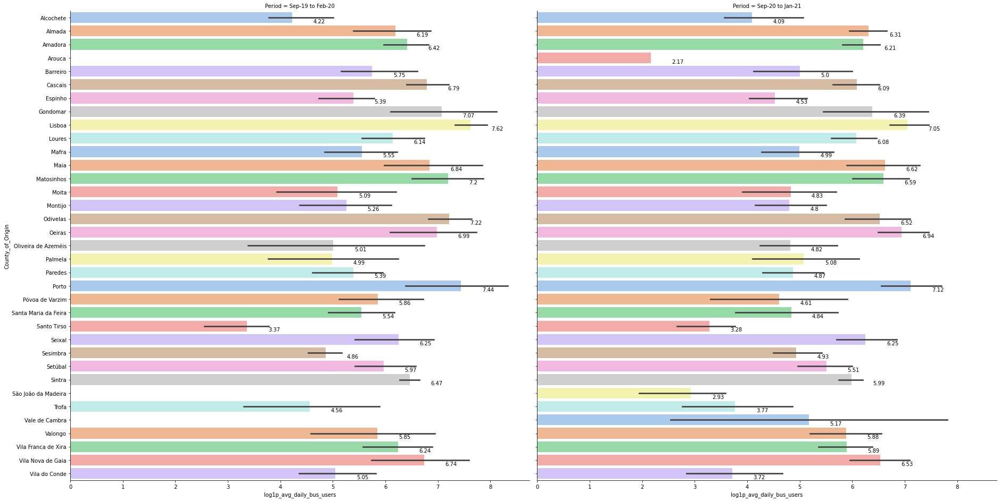

In [48]:
graph = sns.catplot(
    y='County_of_Origin', 
    x='log1p_avg_daily_bus_users', 
    col='Period',
    kind='bar',
    palette='pastel',
    data=user_profiles_df,
    height=13
);
facegrid_show_value_bars(graph, h_v='h')

Findings:
-  Across the board numbers decreased
-  55 and Upwards from Aveiro began using public transport in the second period
-  People from Arouca, Sao Joao da Madeira and Vale De Cambra began using public transport where there was no usage before
-  Very few places increased numbers from before and after; these are the signals we should look for retention
-  For all the places that have reported a decrease; we should look to find common trends among them

### 2: Churn Origin-Destination (OD) Data
Notes:
-  There are no time periods for the churn OD data; would we assume that the routes have not changed across the two different time periods?
-  Vinay has done some analysis; primary findings:
    -  is that Lisboa is the primary hub with several routes leading into it
    -  there are many routes that have the same origin and destination
    -  Q: Routes that start in one city and end in another but traverse through intermediary cities; these connect via other routes?
    
    
Assumptions:
- Assume OD is constants across the two time periods
- Two time periods aren't equal, assume they flatten out when averaged?

In [49]:
# Load churn data
churn_od_df = pd.read_csv(
    os.path.join(data_dir, 'Churn_OD.txt'), 
    delimiter = "|",
    encoding = "ISO-8859-1"
)

#### 2.1: Inspect data
Notes:
-  Origin has region, district, county
-  Destination ends in 'of_Public_Transportation'
-  'Dicofre_ParishCode_of_Public_Transportation', short for 'DIstrito, COncelho, FREguesia' is the neighbourhood region
-  Demand_weight should sum to 1 for each county_origin

In [50]:
churn_od_df.sample(5)

,Region_of_Origin,District_of_Origin,County_of_Origin,Region_of_Public_Transportation,District_of_Public_Transportation,County_of_Public_Transportation,Dicofre_ParishCode_of_Public_Transportation,Demand_weight
1472,R2 - AM Porto,Porto,Gondomar,R2 - AM Porto,PORTO,MATOSINHOS,130812,0.010628
1864,R2 - AM Porto,Porto,Porto,R2 - AM Porto,PORTO,VILA NOVA DE GAIA,131712,0.000001
1729,R2 - AM Porto,Porto,Paredes,R2 - AM Porto,PORTO,VALONGO,131505,0.093906
1598,R2 - AM Porto,Porto,Maia,R1 - AM Lisboa,LISBOA,LOURES,110726,0.000080
688,R1 - AM Lisboa,Lisboa,Vila Franca de Xira,R1 - AM Lisboa,LISBOA,LISBOA,110664,0.001184


In [51]:
churn_od_df.isna().sum()

Region_of_Origin                               0
District_of_Origin                             0
County_of_Origin                               0
Region_of_Public_Transportation                0
District_of_Public_Transportation              0
County_of_Public_Transportation                0
Dicofre_ParishCode_of_Public_Transportation    0
Demand_weight                                  0
dtype: int64

In [52]:
churn_od_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2253 entries, 0 to 2252
Data columns (total 8 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Region_of_Origin                             2253 non-null   object 
 1   District_of_Origin                           2253 non-null   object 
 2   County_of_Origin                             2253 non-null   object 
 3   Region_of_Public_Transportation              2253 non-null   object 
 4   District_of_Public_Transportation            2253 non-null   object 
 5   County_of_Public_Transportation              2253 non-null   object 
 6   Dicofre_ParishCode_of_Public_Transportation  2253 non-null   int64  
 7   Demand_weight                                2253 non-null   float64
dtypes: float64(1), int64(1), object(6)
memory usage: 140.9+ KB


In [53]:

churn_od_df.duplicated().sum()

0

- no missing data 
- no duplicate rows
- 8 by 2253 matrix

#### 2.2: Data wrangling
Data plots for discovery
-  Change naming '_Public_Transportation' to 'Destination'

In [54]:
# change column titles
churn_od_df.columns = churn_od_df.columns.str.replace('_Public_Transportation', '_Destination')

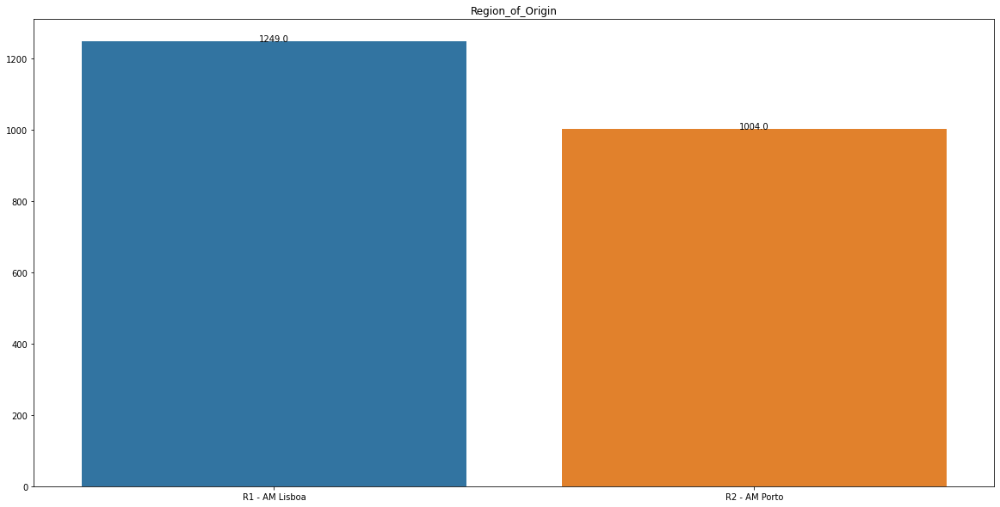

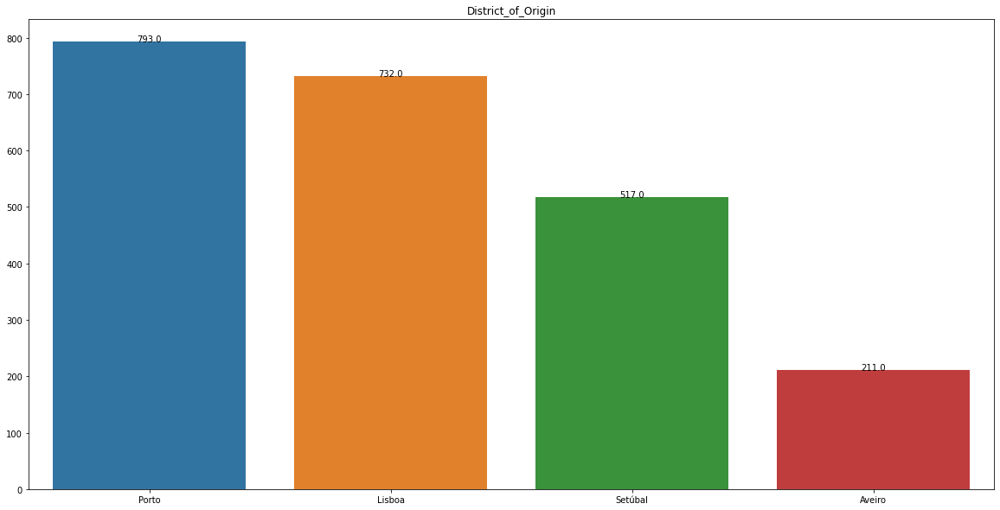

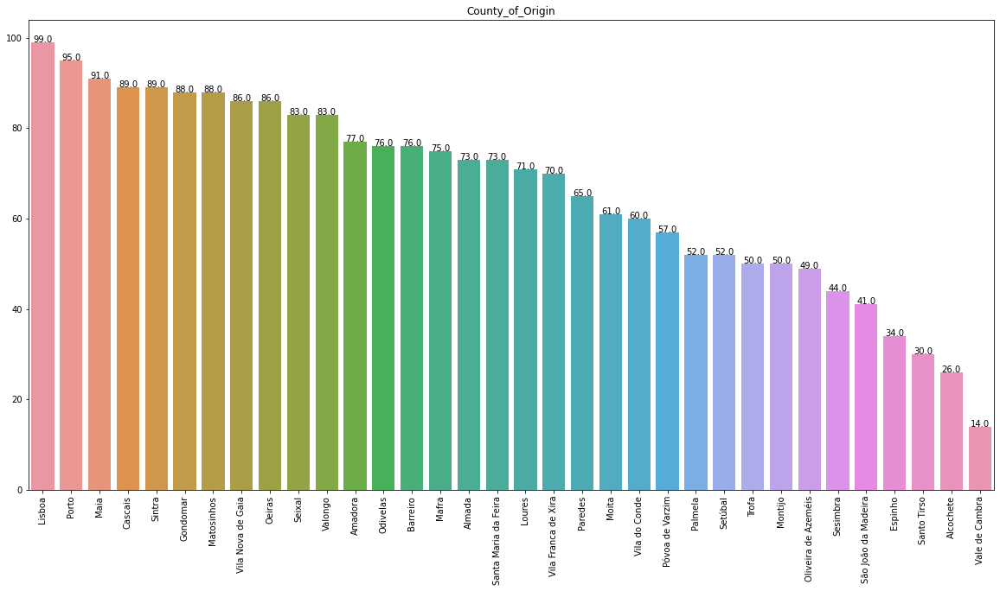

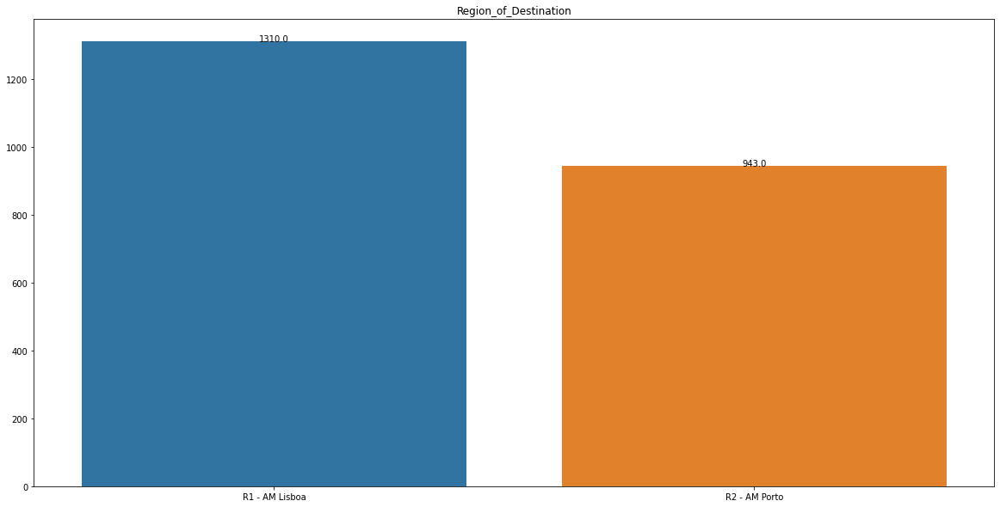

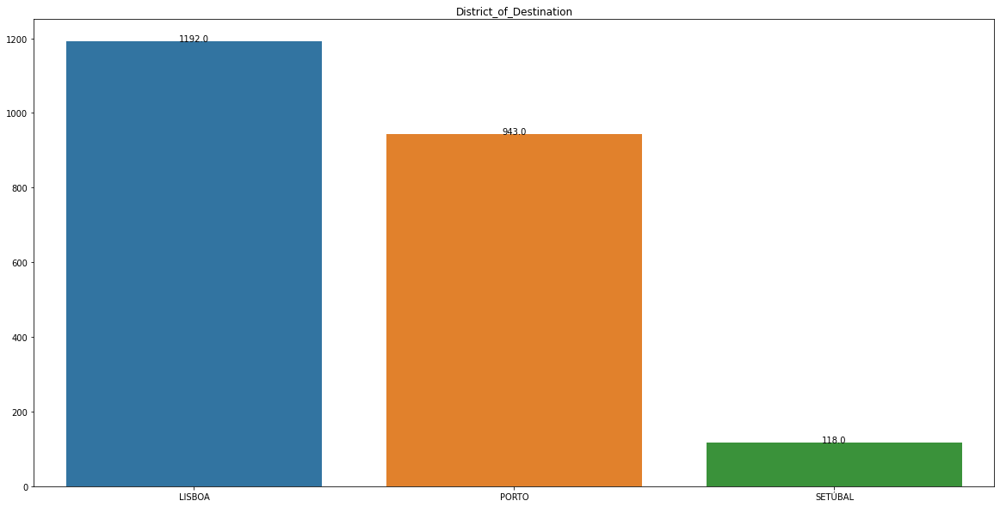

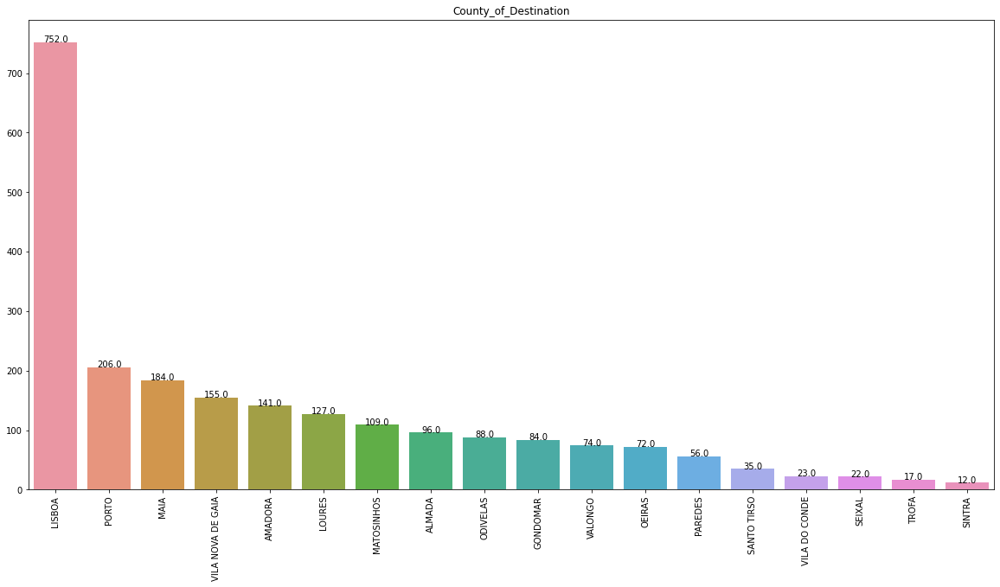

In [55]:
# plot barplots of each origin/destination
for col in churn_od_df.select_dtypes(include='object').columns:
    vcs = churn_od_df[col].value_counts()
    g = sns.barplot(data=churn_od_df, x=vcs.index.values, y=vcs.values)
    plt.title(col)
    show_values_on_bars(g)
    if 'County' in col:
        plt.xticks(rotation=90)
    plt.show()

In [56]:
def move_legend(ax, new_loc, bbox_to_anchor=None, **kws):
    '''
    https://github.com/mwaskom/seaborn/issues/2280
    '''
    old_legend = ax.legend_
    handles = old_legend.legendHandles
    labels = [t.get_text() for t in old_legend.get_texts()]
    title = old_legend.get_title().get_text()
    if bbox_to_anchor is not None:
        ax.legend(handles, labels, loc=new_loc, bbox_to_anchor=bbox_to_anchor, title=title, **kws)
    else:
        ax.legend(handles, labels, loc=new_loc, title=title, **kws)

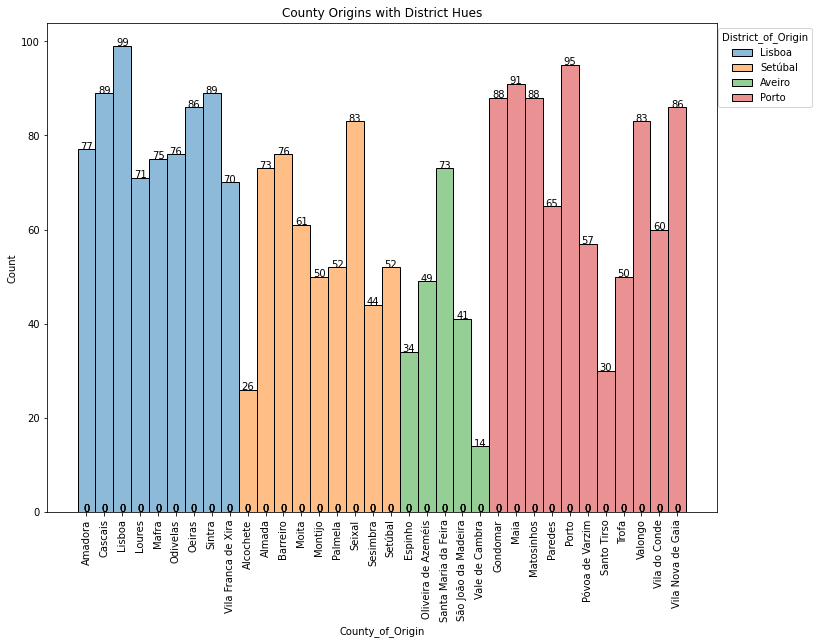

In [57]:
# plot county with hues of district/region for origin/destination
fig, ax = plt.subplots(figsize=(12,9))
g = sns.histplot(data=churn_od_df, x='County_of_Origin', hue='District_of_Origin', ax=ax)
show_values_on_bars(g)
ax.tick_params(axis='x', labelrotation=90)
move_legend(ax, 'upper right', bbox_to_anchor=(1.15, 1))
ax.set_title('County Origins with District Hues');

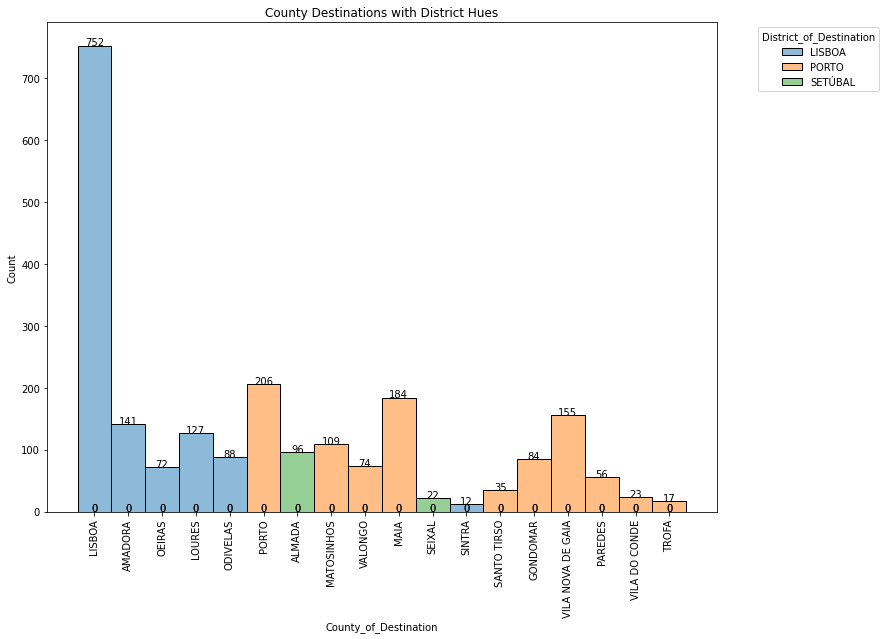

In [58]:
# plot county with hues of district/region for origin/destination
fig, ax = plt.subplots(figsize=(12,9))
g = sns.histplot(data=churn_od_df, x='County_of_Destination', hue='District_of_Destination', ax=ax)
show_values_on_bars(g)
ax.tick_params(axis='x', labelrotation=90)
move_legend(ax, 'upper right', bbox_to_anchor=(1.25, 1))
ax.set_title('County Destinations with District Hues');

In [59]:
churn_od_df['Dicofre_ParishCode_of_Destination'].value_counts()

110608    34
110610    33
110618    33
110654    33
110657    33
          ..
130613     7
130414     6
131806     6
131611     4
131809     4
Name: Dicofre_ParishCode_of_Destination, Length: 100, dtype: int64

Findings:
- Lisboa is a more popular region of origin
- Porto and Lisboa are close in origin districts, Aveiro is the least popular
- Counties vary quite widely in terms of origin locations; perhaps we can try to find out which counties belong to which districts to see if there's a common trend
- Setubal is not even an origin but exists as a destination district
- The most popular county is by far Lisboa, the rest are dwarfed. Raises multiple questions about travel purposes and so on.
- Aveiro has the least number of counties and one with the lowest number of origin passengers
- Aveiro is not even a district for the destination, and Setubal has two destinations. Porto has quite a few by count but Lisboa by far dominates
- There are 100 parish codes; we will not work with these for now but could be valuable to look at later on.


#### 2.3: Visualising types of routes (internal v external)

In [60]:
# breakdown of internal v external routes
churn_od_df['County_of_Origin'] = churn_od_df['County_of_Origin'].str.upper()
routes_count = (churn_od_df.groupby('County_of_Origin')
                           .agg({"County_of_Origin": 'count'})
                           .rename(columns={'County_of_Origin': 'number_of_routes'})
                           .sort_values(by=['number_of_routes'], ascending = False))

churn_od_df_internal = churn_od_df[churn_od_df['County_of_Destination'] == churn_od_df['County_of_Origin']]
churn_od_df_internal_agg = (churn_od_df_internal.groupby('County_of_Origin')
                    .agg({'County_of_Origin': 'count'})
                    .rename(columns={'County_of_Origin': 'number_of_routes_internal'}))
            

routes_count_final = pd.merge(routes_count, churn_od_df_internal_agg, left_index=True, right_index=True,  how = 'inner')
routes_count_final['percentage_of_routes_internal'] = routes_count_final['number_of_routes_internal']/ routes_count_final['number_of_routes']
routes_count_final['number_of_routes_external'] =  routes_count_final['number_of_routes'] - routes_count_final['number_of_routes_internal']
routes_count_final['percentage_of_routes_external'] =  1-  routes_count_final['percentage_of_routes_internal']
routes_count_final

,number_of_routes,number_of_routes_internal,percentage_of_routes_internal,number_of_routes_external,percentage_of_routes_external
County_of_Origin,,,,,
LISBOA,99,24,0.242424,75,0.757576
PORTO,95,7,0.073684,88,0.926316
MAIA,91,10,0.109890,81,0.890110
SINTRA,89,1,0.011236,88,0.988764
GONDOMAR,88,5,0.056818,83,0.943182
MATOSINHOS,88,4,0.045455,84,0.954545
VILA NOVA DE GAIA,86,10,0.116279,76,0.883721
OEIRAS,86,3,0.034884,83,0.965116
VALONGO,83,4,0.048193,79,0.951807


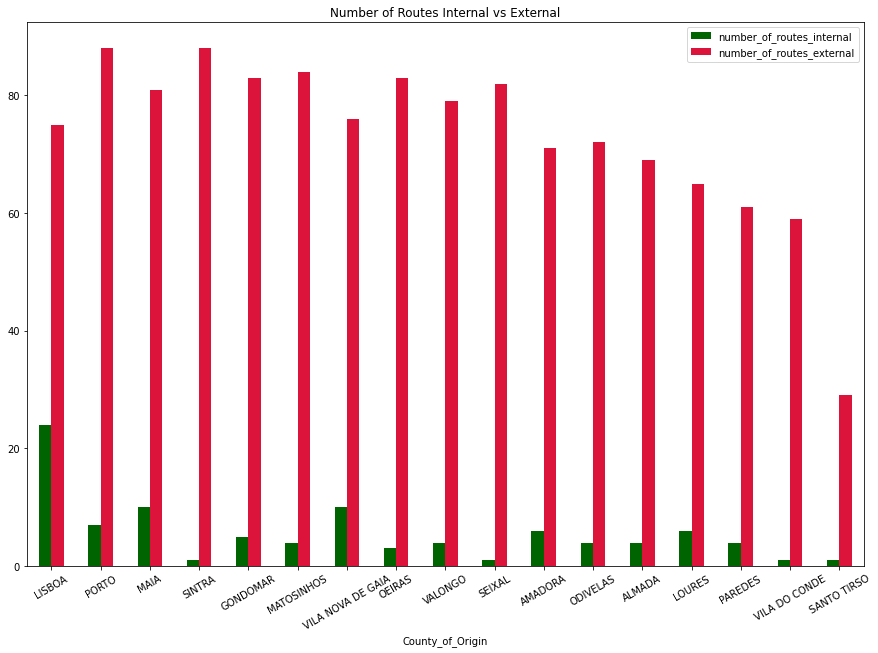

In [61]:
# plot number of internal vs external routes
routes_count_final[
    ['number_of_routes_internal', 'number_of_routes_external']
    ].plot.bar(rot=30, color=['darkgreen', 'crimson'], figsize=(15,10))
plt.title('Number of Routes Internal vs External');

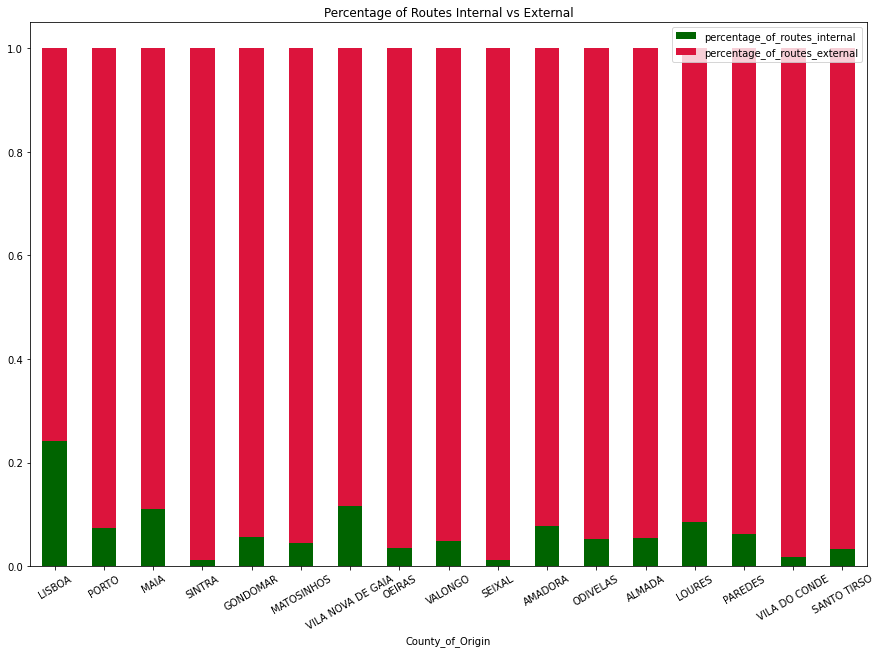

In [62]:
# plot percentage vs external existing bus routes
# important to consider some counties have more parishes
routes_count_final[
    ['percentage_of_routes_internal', 'percentage_of_routes_external']
    ].plot.bar(
    rot=30, color=['darkgreen', 'crimson'], figsize=(15,10), stacked=True
)
plt.title('Percentage of Routes Internal vs External');

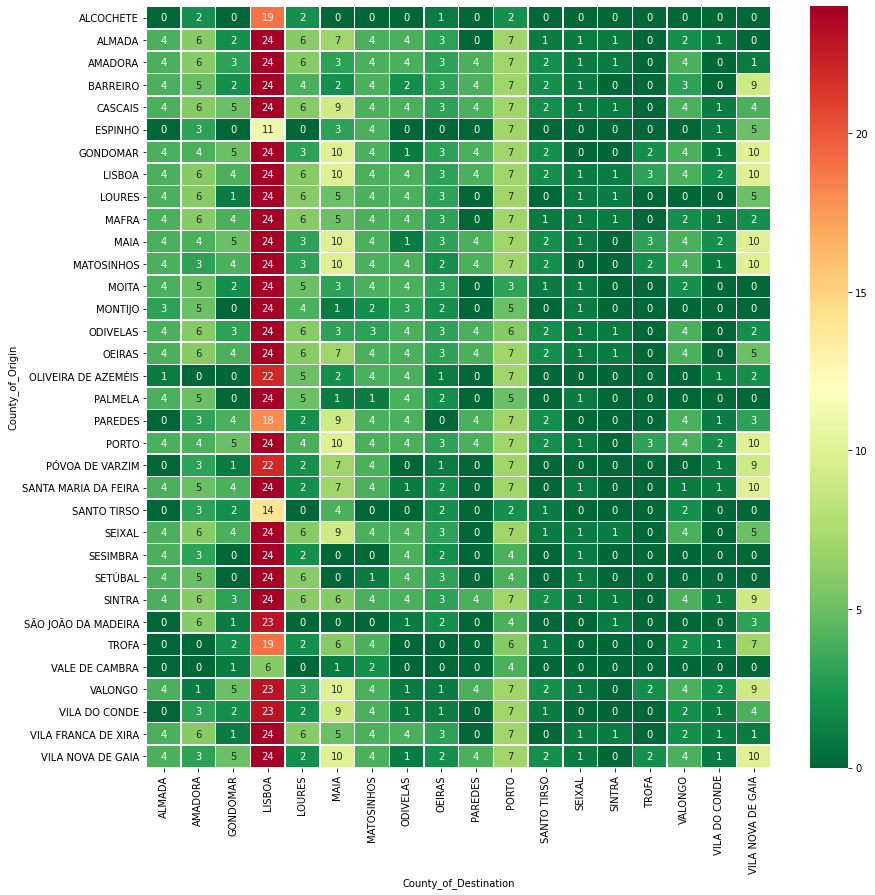

In [63]:
# plot a heatmap
fig, ax = plt.subplots(figsize=(14,14))  
sns.heatmap(
    pd.crosstab(
        churn_od_df.County_of_Origin, 
        churn_od_df.County_of_Destination
    ),
    annot=True,
    cmap='RdYlGn_r', 
    linewidths=0.5,
    ax=ax
);

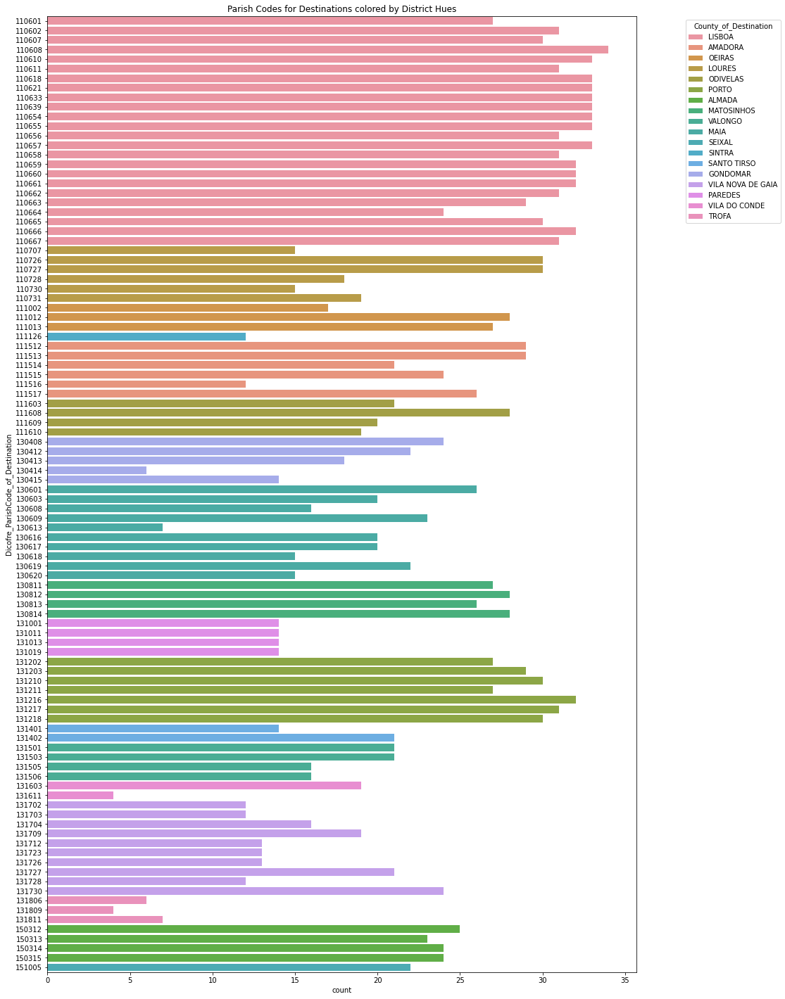

In [64]:
# finally, parish codes
fig, ax = plt.subplots(figsize=(15,25))
sns.countplot(
    y='Dicofre_ParishCode_of_Destination', 
    hue='County_of_Destination',
    dodge=False,
    data=churn_od_df,
);
move_legend(ax, 'upper right', bbox_to_anchor=(1.25, 1))
ax.set_title('Parish Codes for Destinations colored by District Hues');

Findings:
-  There are far more routes going out than there are comming in 
-  Lisboa has the highest number of routes going in
    -  Does this mean all of the other places are going to Lisboa?
    -  Pretty much verified by the heatmap.. Perhaps we can build a graph network next but the heatmap depicts what is happening
-  Parish codes give us more granularity but we only have the destinations.. Can we get the shapefiles or latitude/longitude of these to map out and understand the network effect of what is happening?

#### 2.4 Sankey Diagrams
At the county level

In [65]:
# for plotting sankey diagrams
import plotly.graph_objects as go
import plotly.express as pex
import plotly
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot

In [66]:
origin_destination_county_df = (churn_od_df.groupby(['County_of_Origin','County_of_Destination'])
           .agg({'Demand_weight': 'sum'}))
origin_destination_county_df = origin_destination_county_df.reset_index()

In [67]:
origin_destination_county_df.head(5)

,County_of_Origin,County_of_Destination,Demand_weight
0,ALCOCHETE,AMADORA,0.000734
1,ALCOCHETE,LISBOA,0.989802
2,ALCOCHETE,LOURES,0.008105
3,ALCOCHETE,OEIRAS,0.001209
4,ALCOCHETE,PORTO,0.000154


In [68]:
origin_destination_county_df['County_of_Destination'] = origin_destination_county_df['County_of_Destination'] + '_1'

In [69]:
# everythingg
hv.Sankey(origin_destination_county_df).options(height=3000)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

In [70]:
# plot county by county
for unique_county in origin_destination_county_df['County_of_Origin'].unique():
    tmp_df = origin_destination_county_df[origin_destination_county_df['County_of_Origin']==unique_county]
    tmp_df = tmp_df[tmp_df['Demand_weight'] > 0.0001]
    display(hv.Sankey(tmp_df).options(width=800, height=500))

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

:Sankey   [County_of_Origin,County_of_Destination]   (Demand_weight)

Findings
-  Most places go to Lisboa
-  Espinho, Gondomar, Maia, Santa Maria De Feira goes to Porto mostly
-  There is a strong link between MAIA and Matosinhos
-  Many popular routes go to themself, ex. Lisboa
-  Big parts of routes often go to themself, ex. Oeiras
-  Paredes, Santo Tirso, Valongo is quite evenly split
-  Povoa De Varzim as a lot of weighting to Vila Nova De Gaia
-  Trofa is split between Porto and Lisboa

#### 2.5: Building a Graph Network
Numerically assess the hubs/clusters etc..

In [71]:
import networkx as nx

In [72]:
# just to plot with weights
G = nx.DiGraph()
origin_destination_county_df['County_of_Destination'] = origin_destination_county_df['County_of_Destination'].str.rstrip('_1')
G.add_weighted_edges_from(origin_destination_county_df.values)

In [73]:
def get_kamada_kawai_layout(G):
    df = pd.DataFrame(index=G.nodes(), columns=G.nodes())
    for row, data in nx.shortest_path_length(G):
        for col, dist in data.items():
            df.loc[row,col] = dist
    df = df.fillna(df.max().max())
    return nx.kamada_kawai_layout(G, dist=df.to_dict())

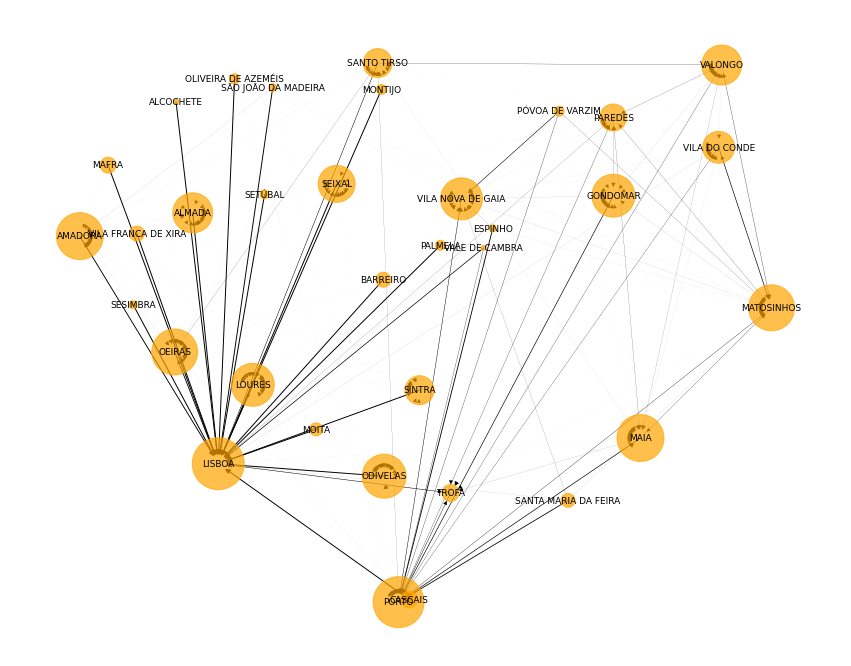

In [74]:
# plot network graph with matplotlib
widths = nx.get_edge_attributes(G, 'weight')
nodelist = G.nodes()

plt.figure(figsize=(15,12))

# pos = get_kamada_kawai_layout(G) 
pos = nx.fruchterman_reingold_layout(G, k=0.5, iterations=100)

node_degrees = dict(G.degree).values()
nx.draw_networkx_nodes(G,pos,
                       nodelist=nodelist,
                       #node_size=3000,
                       node_size=[v**2 for v in node_degrees],
                       node_color='orange',
                       alpha=0.7)
nx.draw_networkx_edges(G,
                       pos,
                       edgelist = widths.keys(),
                       width=list(widths.values()),
                       alpha=1,
                       arrowstyle='-|>'
                       )
nx.draw_networkx_labels(G, pos=pos,
                        labels=dict(zip(nodelist,nodelist)),
                        font_size=9,
                        font_color='black'
                       )
plt.box(False)
plt.show()

In [75]:
# Some analysis
N, K = G.order(), G.size()
avg_deg = float(K) / N
print ("Nodes: ", N)
print ("Edges: ", K)
print ("Average degree of connectedness: ", avg_deg)
print ("Number of Strongly Connected Components: ", nx.number_strongly_connected_components(G))
print ("Number of Weakly Connected Components: ", nx.number_weakly_connected_components(G))

Nodes:  34
Edges:  442
Average degree of connectedness:  13.0
Number of Strongly Connected Components:  17
Number of Weakly Connected Components:  1


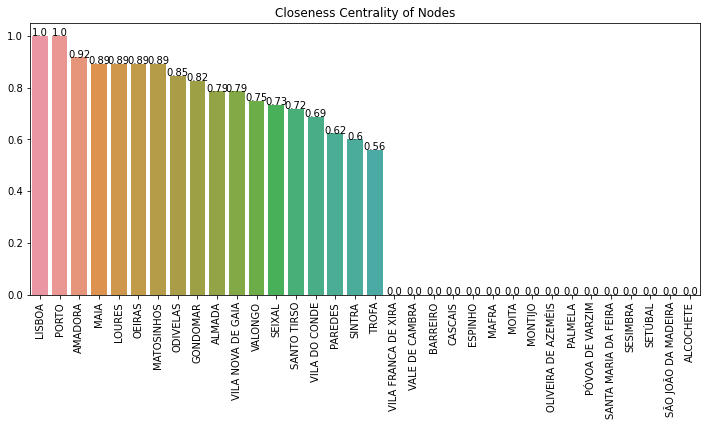

In [76]:
fig, ax = plt.subplots(figsize=(12,5))
tmp_df = pd.Series(nx.closeness_centrality(G)).sort_values(ascending=False)
g = sns.barplot(
    x=tmp_df.index.values,
    y=tmp_df.values,
    ax=ax)
show_values_on_bars(g, decimals=2)
ax.set_title('Closeness Centrality of Nodes')
ax.tick_params(axis='x', labelrotation=90)
plt.show()

In [77]:

# plotting connectedness
for n, p in pos.items():
    G.nodes[n]['pos'] = p

In [78]:
edge_trace = go.Scatter(
    x=[],
    y=[],
    line=dict(width=0.5,color='#888'),
    hoverinfo='none',
    mode='lines')

for edge in G.edges():
    x0, y0 = G.nodes[edge[0]]['pos']
    x1, y1 = G.nodes[edge[1]]['pos']
    edge_trace['x'] += tuple([x0, x1, None])
    edge_trace['y'] += tuple([y0, y1, None])

In [79]:
node_trace = go.Scatter(
    x=[],
    y=[],
    text=[],
    mode='markers',
    hoverinfo='text',
    marker=dict(
        showscale=True,
        colorscale='RdBu',
        reversescale=True,
        color=[],
        size=15,
        colorbar=dict(
            thickness=10,
            title='Node Connections',
            xanchor='left',
            titleside='right'
        ),
        line=dict(width=0)))

for node in G.nodes():
    x, y = G.nodes[node]['pos']
    node_trace['x'] += tuple([x])
    node_trace['y'] += tuple([y])

In [80]:
for node, adjacencies in enumerate(G.adjacency()):
    node_trace['marker']['color']+=tuple([len(adjacencies[1])])
    node_info = adjacencies[0] +' # of connections: '+str(len(adjacencies[1]))
    node_trace['text']+=tuple([node_info])

### 3: Purchasing Power Per Capita (PPPC) Data

In [81]:
# importing 
PPPC_Individual_journeys_Data_url = 'https://raw.githubusercontent.com/Hardi-Lior/WDL/main/Stage_1/data/PPPC_Individual_journeys_Data.csv'
PPPC_Individual_journeys_Data_df = pd.read_csv(PPPC_Individual_journeys_Data_url)

In [82]:
PPPC_Individual_journeys_Data_df.head()

,County_of_Origin,Period,GenderDescription,AgeClassDescription,Avg_BusUsers_Daily_County_of_Transportation,County_of_Transportation,County_of_Origin_Purchasing_Power_Per_Capita,County_of_Transportation_Purchasing_Power_Per_Capita,percent_dif_OD_PPPC
0,alcochete,Sep-19 to Feb-20,Female,25-34,47.247936,lisboa,118.8,219.6,0.848485
1,alcochete,Sep-19 to Feb-20,Female,45-54,42.277080,lisboa,118.8,219.6,0.848485
2,alcochete,Sep-19 to Feb-20,Male,35-44,146.990102,lisboa,118.8,219.6,0.848485
3,alcochete,Sep-20 to Jan-21,Female,55-64,33.852956,lisboa,118.8,219.6,0.848485
4,alcochete,Sep-20 to Jan-21,Male,35-44,156.184036,lisboa,118.8,219.6,0.848485


We know that seixal and vila franca de xira are the two countires that wheren't included in the Purchasing_Power_Per_Capita_Data_set.Therefor, PPPC_Individual_journeys_Data_df doesn't have data on those two counties as it was omited from the data 

#### 3.1 Visualisation 

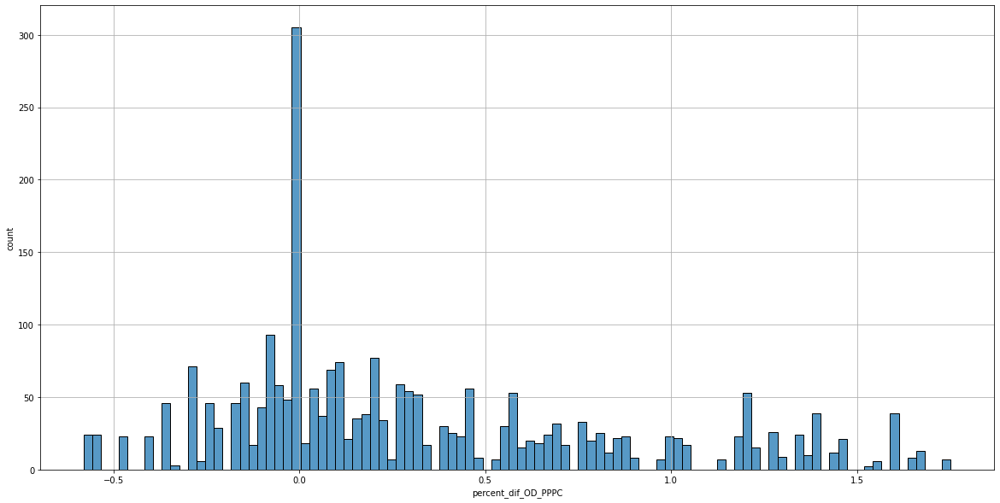

In [83]:
ax = sns.histplot(PPPC_Individual_journeys_Data_df['percent_dif_OD_PPPC'],bins=100)
ax.set_title('')
ax.set_ylabel('count')

ax.grid(b=True, which='major')
ax.grid(b=True, which='minor')

the data is skewed right this mean :
- more people travel to counties with higher purchesing power 
- as lisboa has alot to of internal travel and other place we get a concetration about the percent_dif_OD_PPPC = 0


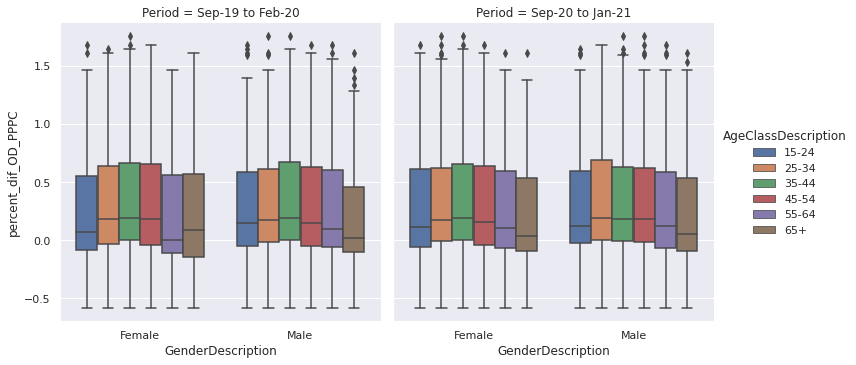

In [84]:
sns.set(style="ticks")
sns.set_style("darkgrid")
g = sns.catplot(x="GenderDescription", y="percent_dif_OD_PPPC",
                hue="AgeClassDescription",
                hue_order=['15-24','25-34','35-44','45-54','55-64','65+'],
                col="Period",data=PPPC_Individual_journeys_Data_df, kind="box");
plt.show()

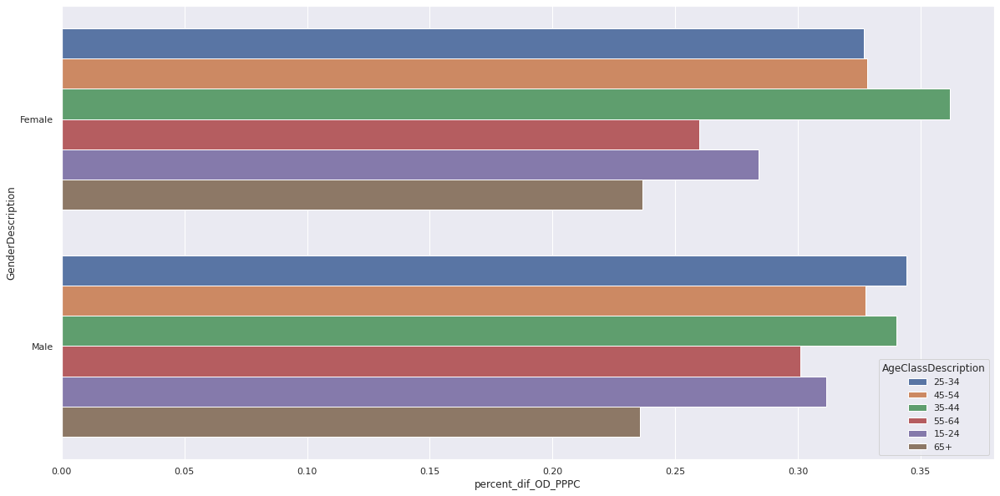

In [85]:
col = 'GenderDescription'
graph1 = sns.barplot(data = PPPC_Individual_journeys_Data_df
                    , x = 'percent_dif_OD_PPPC'
                    , y = col
                    , hue = 'AgeClassDescription'
                    # , col = 'GenderDescription'
                    , palette=None
                    , ci = None)

### 4: Investigating Signals and Noise within User Groups
Approaches:
-  Model user groups
    -  Perhaps use simple models due to the low variance of the datasets (linear models with bayseian optimisers??)
    -  Miguel: https://docs.pymc.io/pymc-examples/examples/case_studies/multilevel_modeling.html
    -  Combine network connectivity and weightings of counties somehow? hmm
Assumptions:
-  Demographic distributions that use the public transport is even?


#### 4.1: Merging Datasets together

In [86]:
routes_count_final.index = routes_count_final.index.str.title()
user_profiles_df['County_of_Origin'] = user_profiles_df['County_of_Origin'].str.title()

In [87]:
# remove any demand weight less than 0.001
filtered_od_county_df = origin_destination_county_df[origin_destination_county_df['Demand_weight'] > 0.001]

# groupby and get groups
grpby = filtered_od_county_df.groupby('County_of_Origin')
grpby_dicts = [grpby.get_group(x) for x in grpby.groups]

In [88]:
# merge all the dfs
merged_dfs = []
for i in range(len(grpby_dicts)):
    gdict = grpby_dicts[i].T
    gdict.columns = [f'Prob_{x.title()}' for x in gdict.loc['County_of_Destination'].values]
    county_origin_name = gdict.loc['County_of_Origin'].values[0].title()
    gdict['County_of_Origin'] = county_origin_name
    gdict.drop(['County_of_Origin', 'County_of_Destination'], inplace=True)
    

    merging_df = pd.merge(
        left=user_profiles_df,
        right=gdict,
        how='left',
        left_on='County_of_Origin',
        right_on='County_of_Origin'
    )
    merged_dfs.append(merging_df[merging_df['County_of_Origin']==county_origin_name])

In [89]:
# merge as one big df
concatenated_df = pd.concat(merged_dfs, axis=0, ignore_index=True)

In [90]:
for col in concatenated_df:
    if col.startswith('Prob_'): 
        concatenated_df[col] = concatenated_df[col].astype(float)

In [91]:
# we lose a column; this is the one we lose; there is no OD for this?
pd.concat(
    [
        user_profiles_df[user_profiles_df.columns[:7]],
        concatenated_df[concatenated_df.columns[:7]]
    ]
    ).drop_duplicates(keep=False)

,District_of_Origin,County_of_Origin,Period,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day,origin_region_number
428,Aveiro,Arouca,Sep-20 to Jan-21,Male,35-44,7.725698,R2


In [92]:
origin_destination_county_df.loc[origin_destination_county_df['County_of_Origin']=='Aveiro']

,County_of_Origin,County_of_Destination,Demand_weight


Findings:
-  OD Matrix doesn't have Aveiro-Arouca route in the second period; means that the OD matrix is likely from the first period, and that perhaps this is a new route established or was under maintainence during the first period

We now have the probability of users going to each destination; we can perhaps plot visualisations as to the demographics travelling to places.

Q: 
-  Do we want to just plot out the demographics for the first period as they are the ones in which the OD matrix data applies? Or do we continue to assume the OD matrix data can apply for both periods and leave out Aveiro-Arouca

#### 4.2 Mapping out user flows
Approach:
-  We'll just map out county to county for now
-  Drop routes internal/external

We found out that OD applies to both periods..

In [93]:
# fill na with zero for float cols
for float_col in concatenated_df.columns[concatenated_df.dtypes==float]:
    concatenated_df[float_col].fillna(0, inplace=True)

# drop district and region information; as well as log1p
concatenated_df.drop(
    ['District_of_Origin','origin_region','log1p_avg_daily_bus_users', 'origin_region_number'], 
    axis=1, inplace=True)

In [94]:
# make lookup table here
concat_probability_lookup_df = []
for col in concatenated_df:
    if col.startswith('Prob_'):
        concat_probability_lookup_df.append(col)
concat_probability_lookup_df = concatenated_df[concat_probability_lookup_df]

In [95]:
# get col of num_actual_visitors by multiplying
for col in concatenated_df:
    if col.startswith('Prob_'):
        new_colname = col.replace('Prob_', 'Avg_BusUsers_Daily_to_')
        concatenated_df[new_colname] = concatenated_df[col] * concatenated_df['Average_BusUsers_per_Day']
        concatenated_df.drop(col, axis=1, inplace=True)

In [96]:
# map periods
concatenated_df['Period'] = concatenated_df['Period'].map({
    'Sep-19 to Feb-20':1,
    'Sep-20 to Jan-21':2
})

In [97]:
concatenated_df.sample(2)

,County_of_Origin,Period,GenderDescription,AgeClassDescription,Average_BusUsers_per_Day,Avg_BusUsers_Daily_to_Lisboa,Avg_BusUsers_Daily_to_Loures,Avg_BusUsers_Daily_to_Oeiras,Avg_BusUsers_Daily_to_Almada,Avg_BusUsers_Daily_to_Amadora,Avg_BusUsers_Daily_to_Odivelas,Avg_BusUsers_Daily_to_Porto,Avg_BusUsers_Daily_to_Matosinhos,Avg_BusUsers_Daily_to_Vila Nova De Gaia,Avg_BusUsers_Daily_to_Gondomar,Avg_BusUsers_Daily_to_Maia,Avg_BusUsers_Daily_to_Valongo,Avg_BusUsers_Daily_to_Paredes,Avg_BusUsers_Daily_to_Santo Tirso
73,Cascais,1,Female,55-64,756.408177,730.459594,1.297996,14.675831,0.0,7.693428,0.0,1.143689,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0
188,Maia,1,Female,45-54,814.760142,8.906143,0.000000,0.000000,0.0,0.000000,0.0,535.741458,164.135875,0.0,6.425198,94.672684,4.152018,0.0,0.0


In [98]:
## Mapping out shapefiles
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster, HeatMap, HeatMapWithTime

In [99]:
# download from http://mapas.dgterritorio.pt/ATOM-download/CAOP-Cont/Cont_AAD_CAOP2020.zip; unzip
# load portugal county shapefiles
portugal_gdf = gpd.read_file('/content/Cont_AAD_CAOP2020.shp')
portugal_gdf = portugal_gdf.to_crs('EPSG:4326')
portugal_gdf.shape

(3223, 9)

In [100]:
# rename colmns
portugal_gdf.rename({
    'Dicofre':'Parish_code',
    'Freguesia':'Municipality',
    'Concelho':'County',
    'Distrito':'District'
}, axis=1, inplace=True)

In [101]:
portugal_gdf['County'] = portugal_gdf['County'].str.title()

In [102]:
# there are 3000+ counties; filter to the ones we want to investigate
unique_counties = np.unique(np.concatenate(
    (origin_destination_county_df['County_of_Origin'].str.title().unique(),
    origin_destination_county_df['County_of_Origin'].str.title().unique())
))
portugal_gdf = portugal_gdf.loc[portugal_gdf['County'].str.title().isin(unique_counties)]
portugal_gdf.shape

(344, 9)

In [103]:
portugal_gdf.sample(2)

,Parish_code,Municipality,County,District,TAA,Area_T_ha,Area_EA_ha,Des_Simpli,geometry
634,150607,União das freguesias de Baixa da Banheira e Va...,Moita,Setúbal,ÁREA PRINCIPAL,642.05,642.05,Baixa da Banheira e Vale da Amoreira,"POLYGON ((-9.03619 38.65240, -9.03618 38.65238..."
2073,010705,Silvalde,Espinho,Aveiro,ÁREA PRINCIPAL,545.48,545.48,Silvalde,"POLYGON ((-8.60624 40.98613, -8.60627 40.98605..."


In [104]:
# add colours to each county
import random

def check_all_unique(fn, *args):
    flag=False
    while flag==False:
        result = fn(*args)
        if len(result) == len(set(result)):
            return result
        
def gen_random_hexnum(num_colors):
    return ['#'+format(random.randint(0,16777215),'x') for i in range(num_colors)]

def gen_random_colours(num_colors):
    return [(random.random(), random.random(), random.random()) for i in range(num_colors)]

In [105]:
# assign hexcolours tocounties
county_colours_dict = dict(zip(
    portugal_gdf['County'].unique(),
    check_all_unique(gen_random_hexnum, len(portugal_gdf['County'].unique())))
)
portugal_gdf['colour'] = portugal_gdf['County'].map(county_colours_dict)

In [106]:
m = folium.Map([39.465063, -8.473743], zoom_start=7, width=500, height=500, tiles="cartodbpositron")

folium.GeoJson(portugal_gdf).add_to(m)


In [107]:
def make_county_popup_from_row(row):
    
    html = f'''County: {row['County']} <br>
    Municipality: {row['Municipality']}<br>
    District: {row['District']}<br>
    '''

    iframe = folium.IFrame(html,
                           width=300,
                           height=100)

    popup = folium.Popup(iframe,
                         max_width=300)
    return popup

In [108]:
def add_gdf_markers_to_map(gdf, m):
    #https://stackoverflow.com/questions/62228489/python-folium-how-to-create-a-folium-map-marker-with-multiple-popup-text-line
    gdf['lon'] = gdf.centroid.x
    gdf['lat'] = gdf.centroid.y
    
    fg = folium.FeatureGroup(name='County Clustered Points', show=False)
    m.add_child(fg)
    marker_cluster = MarkerCluster().add_to(fg)

    for _, r in gdf.iterrows():   
        folium.Marker(
            location=[r['lat'], r['lon']], 
            popup=make_county_popup_from_row(r)
        ).add_to(marker_cluster)

In [109]:
add_gdf_markers_to_map(portugal_gdf, m)
m

we can create a map the individual counties that we are interested. to better understand the local stress point in the public transport system.

In [110]:
# build heatmap
sum_county_series = concatenated_df.groupby('County_of_Origin').agg('sum')['Average_BusUsers_per_Day']
sum_county_dict = round(sum_county_series.apply(np.log10), 2)

heatmap_df = portugal_gdf[['County', 'lon', 'lat', 'geometry']]
heatmap_df['sum_bususers_daily']= heatmap_df['County'].map(sum_county_dict)

In [111]:
# add to map
heatmap_data = heatmap_df[['lat','lon', 'sum_bususers_daily']].values
HeatMap(heatmap_data, name='Bus Users Sum Heatmap', show=False).add_to(m) # have heatmap p1 andheatma p2

In [112]:
folium.LayerControl().add_to(m)
m

In [113]:
## more ambitious; heatmap with time (log10 of sum Avg. Bususers Daily)
heatmap_df_time = concatenated_df.groupby(['Period', 'County_of_Origin']).agg('sum')['Average_BusUsers_per_Day']
heatmap_df_time = round(np.add(heatmap_df_time,1).apply(np.log10),2).reset_index()

In [114]:
heatmap_merged_df = pd.merge(
    heatmap_df_time,
    portugal_gdf[['County', 'lon', 'lat', 'geometry']],
    left_on='County_of_Origin',
    right_on='County'
)
heatmap_merged_df.rename({'Average_BusUsers_per_Day': 'log10_sum_bususers'}, axis=1, inplace=True)

In [115]:
heatmap_p1_data = heatmap_merged_df.loc[heatmap_merged_df['Period']==1][['lat','lon', 'log10_sum_bususers']].values
heatmap_p2_data = heatmap_merged_df.loc[heatmap_merged_df['Period']==2][['lat','lon', 'log10_sum_bususers']].values

In [116]:
heatmap_p1_data = np.where(np.isnan(heatmap_p1_data), 0, heatmap_p1_data)
heatmap_p2_data = np.where(np.isnan(heatmap_p2_data), 0, heatmap_p2_data)

In [117]:
HeatMap(heatmap_p1_data, name='P1 Heatmap; log10 sum', show=False).add_to(m) # have heatmap p1 andheatma p2
HeatMap(heatmap_p2_data, name='P2 Heatmap; log10 sum', show=False).add_to(m) # have heatmap p1 andheatma p2

In [118]:
folium.LayerControl().add_to(m)
m

## Conclusions

### Scalability and Impact

- From the data we can say that the trends across both data sets is negative as the churn rates are negative.
- The negative trends can't be taken as face value because the second Period **period2** overlaps with period of lockdown due to covid-19 Pandemic. this means that the majority of the negative trend argued to be caused by covid-19.
-Never the less, we can gline some infomation:
  1. Improve the image of public transport, from a last resort of transport to a reliable service the they can depend on a day to day life.
  2. Adjust the post pandemic service to improve cleaning public transport 
  3. Intermodal solutions that need simplified as public transport service in Portugal is made up of buses, railway (subway, train, and tram), and ferry. 
  4. Service should be designed to accommodate the levels of service required by passengers (Reis, 2018)


---

**However, the main reason for leaving or returning to public transport use—a change  in the workplace/school/residence—is related to specific features of the transport service**(Reis, 2018)

---

How the solution is applicable and scalable if it were to implement it in a city? 
The scalablility is very attainable as our solution is to improve the image of the public transport to a more reliable one as there is enough to say anything in concrete. But it will be hard to improve the reliablity by having transport being on time (the bus services).


Possible limitations and measure the potential social impact of your solution?
Its hard to tell the potential social impact as the lockdown, as training/ hiring people to implement the services.


### Future Work
To be able to build relible models from we need more a complete data set:
- We can only postulate why anyone will take a jurney so we can't pin point the indicator of user reason to use public transform.
- we need data on the unemplyment rate, more granular time data on the public transport, data on public transport in which we can filter on the type of public transport.

These data sets will allow us id why person might travel to a certain county and the choice transport to get there. This will give the us to train a churn models that will give us a better insight the state of the public transport.

### Reference:
1.   Reis, P. V. (2018). Ex-regular Users of Public Transport: Their Reasons for Leaving and Returning. 101-116.
2.   Seaborn Barplot - Displaying Values. (2021, april 15). Retrieved from https://stackoverflow.com/questions/43214978/seaborn-barplot-displaying-values
3.   PORDATA - Displaying Values. (2021, april 15). Retrieved from https://www.pordata.pt/Municipios/%C3%8Dndice+de+envelhecimento-458

